# **Credit Card Fraud Detection**

![logo](images/credit-card-fraud-detection.webp)

## Introdução

O objetivo deste projeto é desenvolver um modelo de *Machine Learning* capaz de identificar transações fraudulentas em cartões de crédito. Usando informações disponíveis, o modelo aprenderá a diferenciar as transações legítimas das fraudulentas.

O modelo vai ser desenvolvido utilizando a linguagem **Python** e vai ser testado e treinado com dados de um *dataset* disponível no [Kaggle](https://www.kaggle.com/datasets/mlg-ulb/creditcardfraud).

A abordagem realizada seguirá a metodologia **CRISP-DM** (Cross-Industry Standard Process for Data Mining), que inclui as seguintes etapas: compreensão do tema, compreensão dos dados, preparação dos dados, modelagem, avaliação e implantação.

## Estrutura do Projeto

O projeto é composto por:

- code.ipynb: *Juptyer Notebook* com a abordagem realizada e o código desenvolvido;
- images: pasta com as imagens utilizadas no projeto.
- CreditCardFraudDetection: pasta com o *dataset* utilizado no projeto.

## Tecnologias Utilizadas

Como já foi referido, a linguagem de programação utilizada será o *Python* e as bibliotecas utilizadas foram:

- *Matplotlib* e *Seaborn* para visualização dos dados;
- *Pandas* para manipulação dos dados;
- *NumPy* para tratar os dados númericos;
- *Scikit-learn* para desenvolver o modelo de *Machine Learning*.

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sb
import pandas as pd
import numpy as np
import folium
from scipy.stats import chi2_contingency
from datetime import datetime
import re
from sklearn.impute import KNNImputer

import warnings
%matplotlib inline
warnings.filterwarnings('ignore')

## Compreensão do Tema
 
Os cartões de crédito são atualmente um dos meios de pagamento mais adotados, especialmente com a expansão do comércio online. Contudo, essa evolução aumentou a exposição dos utilizadores a fraudes, sendo a segurança um aspeto essencial tanto para as instituições financeiras quanto para os consumidores.

Este problema tem como objetivo prever se uma transação de cartão de crédito é **legítima** ou **fraudulenta**, utilizando um *dataset*. A necessidade principal é identificar transações suspeitas com precisão, de forma a prevenir impactos negativos financeiros.

O objetivo do modelo consiste em classificar cada transação num dos dois grupos mutuamente exclusivos:
- **Legítima**: Transação autorizada, realizada pelo titular do cartão.
- **Fraudulenta**: Transação não autorizada, efetuada por terceiros.

Para abordar o problema, será desenvolvido um modelo de *machine learning* especializado em classificação binária, capaz de distinguir transações legítimas das fraudulentas com alto grau de precisão. 

O modelo será treinado utilizando uma abordagem de *supervised learning*, com a meta de alcançar uma alta taxa de precisão e recall nos dados de teste, assegurando eficácia prática e capacidade de minimizar falsos positivos e falsos negativos na deteção de fraudes.

## Compreensão dos Dados

Antes de começar a compreender os dados, é necessário importar os vários ficheiros e juntá-los num único *dataset*.

In [35]:
cities = pd.read_csv('CreditCardTransactions/cities.csv')
customers = pd.read_csv('CreditCardTransactions/customers.csv')
merchants = pd.read_csv('CreditCardTransactions/merchants.csv')
transactions = pd.read_csv('CreditCardTransactions/transactions.csv')

# Merge do customers.csv e cities.csv usando 'city'
customers_cities = pd.merge(customers, cities, on='city', how='left')

# Merge do transactions.csv e customers_cities usando 'cc_num'
transactions_customers = pd.merge(transactions, customers_cities, on='cc_num', how='left')

# Merge final do transactions_customers e merchants.csv usando 'merchant'
final_data = pd.merge(transactions_customers, merchants, on='merchant', how='left')

# Guardar o resultado final
final_data.to_csv('CreditCardTransactions/merged_dataset.csv', index=False)

data = pd.read_csv('CreditCardTransactions/merged_dataset.csv')

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 25 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   index                  30000 non-null  int64  
 1   trans_date_trans_time  29900 non-null  object 
 2   cc_num                 30000 non-null  int64  
 3   device_os              12036 non-null  object 
 4   merchant               30000 non-null  object 
 5   amt                    29900 non-null  float64
 6   trans_num              30000 non-null  object 
 7   unix_time              30000 non-null  int64  
 8   is_fraud               30000 non-null  int64  
 9   first                  29990 non-null  object 
 10  last                   29990 non-null  object 
 11  gender                 29990 non-null  object 
 12  street                 29990 non-null  object 
 13  city                   29990 non-null  object 
 14  zip                    29784 non-null  float64
 15  jo

O *dataset* é constituído por **30000** entradas e **25** colunas. Cada entrada representa uma transação de cartão de crédito. As colunas contêm informações sobre a transação, como o valor, a data, a localização, entre outros que vamos ver com detalhe mais à frente.

Além disso, a dimensionalidade parece adequada para o problema em questão e, tendo em conta que os dados parecem ser consistentes e provenientes da mesma fonte, não se espera encontrar problemas significativos de compatibilidade ou coerência.

In [36]:
data.head()

,index,trans_date_trans_time,cc_num,device_os,merchant,amt,trans_num,unix_time,is_fraud,first,...,job,dob,lat,long,city_pop,state,category,merch_lat,merch_long,merchant_id
0,5381,2023-01-01 00:39:03,2801374844713453,NaN,Merchant_85,252.75,TRANS_662964,1672533543,0,Jane,...,NaN,2002-10-12,41.8781,-87.6298,2716000.0,IL,NaN,NaN,76.433212,85.0
1,4008,2023-01-01 01:16:08,3460245159749480,NaN,Merchant_23,340.17,TRANS_134939,1672535768,0,Alice,...,Nurse,2001-12-23,40.7128,-74.0060,8419600.0,NY,Entertainment,27.177588,-64.857435,23.0
2,1221,2023-01-01 01:24:28,7308701990157768,macOS,Merchant_70,76.38,TRANS_258923,1672536268,0,Bob,...,Doctor,1978-12-13,33.4484,-112.0740,1680992.0,AZ,Electronics,31.730070,-67.777407,70.0
3,9609,2023-01-01 02:06:57,8454886440761098,X11,Merchant_33,368.88,TRANS_226814,1672538817,0,Mike,...,Teacher,1965-04-21,33.4484,-112.0740,1680992.0,AZ,Electronics,-5.005953,146.873847,33.0
4,5689,2023-01-01 02:10:54,6350332939133843,NaN,Merchant_90,323.32,TRANS_668449,1672539054,0,Mike,...,Nurse,1997-05-17,40.7128,-74.0060,8419600.0,NY,Groceries,79.065894,40.668693,90.0


Assim, vamos analisar com mais detalhe os atributos do *dataset*.

| **Atributo**            | **Tipo**        | **Significado**                                                  |
|--------------------------|-------------------------|-------------------------------------------------------------------|
| `index`                  | Categório Nominal  | Identificador único para cada linha do dataset                |
| `trans_date_trans_time`  | Categórico Ordinal  | Data e hora da transação                           |
| `cc_num`                 | Categório Nominal  | Número do cartão de crédito utilizado na transação               |
| `device_os`              | Categórico Nominal     | Sistema operativo do dispositivo utilizado para a transação    |
| `merchant`               | Categórico Nominal     | Nome/Identificador do comerciante                             |
| `amt`                    | Numérico Ratio     | Valor da transação (em unidades monetárias)                      |
| `trans_num`              | Categórico Nominal    | Identificador único para cada transação                          |
| `unix_time`              | Numérico Intervalo    | Timestamp Unix que representa a data e hora da transação         |
| `is_fraud`               | Categório Nominal     | Indicador de fraude na transação (`0`: Não fraudulenta, `1`: Fraudulenta) |
| `first` e `last`         | Categórico Nominal     | Primeiro e último nome do titular do cartão                      |
| `gender`                 | Categórico Nominal     | Género do titular do cartão                                       |
| `street`                 | Categórico Nominal     | Nome da rua                                                      |
| `city`                   | Categórico Nominal     | Cidade do cliente                                                |
| `zip`                    | Categório Nominal   | Código postal                                                    |
| `state`                  | Categórico Nominal     | Estado                                                           |
| `job`                    | Categórico Nominal     | Profissão do titular do cartão                                   |
| `dob`                    | Categórico Ordinal | Data de nascimento do titular do cartão                          |
| `lat` e `long`           | Numérico Ratio     | Latitude e longitude da localização do cliente                   |
| `city_pop`               | Numérico Ratio     | População da cidade onde o cliente reside                        |
| `category`               | Categórico Nominal     | Categoria do comerciante                                         |
| `merch_lat` e `merch_long`| Numérico Ratio     | Latitude e longitude do comerciante                              |
| `merchant_id`            | Categórico Nominal   | Identificador único do comerciante                               |

Os atributos **device_os**, **amt**, **unix_time**/**trans_data_trans_time**, **gender**, **job**, **category**, **city**, **cc_num**, **merchant**/**merchant_id**, **trans_num** e **dob** parecem ser os mais relevantes para detetar fraude, pois parecem ter mais relação com a variável alvo **is_fraud**. Estes serão mais analisados e tratados nas próximas etapas.

Existem, também, vários atributos relacionados com a localização, como por exemplo, **lat**, **long**, **city_pop**, **zip**, **state**, **street**, **merch_lat** e **merch_long**. Estes atributos podem ser úteis para o modelo, contudo é necessário analisar a sua relevância e correlação com a variável alvo e perceber se são todos necessários, pois parecem ser redundantes quando usados em conjunto.

Em contrapartida, os atributos **index**, **first** e **last** são irrelevantes para o modelo, pois são identificadores únicos ou informações que não têm relação com a variável alvo. Deverão, portanto, ser removidos numa próxima etapa.

Para sumarizar os dados foram calculadas algumas estatística das variáveis que parecem ter maior relevância para a deteção de fraude.

Os valores médios das transações fraudulentas (253.25) e não fraudulentas (250.00) são muito próximos, o que indica que o montante médio não é, por si só, um indicador significativo de fraude. No entanto, a análise dos quartis revela uma leve tendência das transações fraudulentas terem valores um pouco mais altos, como evidenciado pela mediana, que é ligeiramente maior nos casos fraudes (256.65 contra 249.53).

Outro ponto relevante é o desvio padrão das transações. As fraudulentas possuem um desvio padrão ligeiramente menor (138.69), sugerindo que os valores de fraudes são menos variados e mais concentrados. Além disso, os valores mínimos das fraudes (2.39) são maiores do que os das transações não fraudulentas (1.01), indicando que transações fraudulentas tendem a não ocorrer em valores extremamente baixos.

In [37]:
fraud_stats = {
    'Não Fraude': data[data['is_fraud'] == 0]['amt'].describe(),
    'Fraude': data[data['is_fraud'] == 1]['amt'].describe()
}

fraud_stats_df = pd.DataFrame(fraud_stats)
print(fraud_stats_df)

         Não Fraude      Fraude
count  29331.000000  569.000000
mean     250.001425  253.252179
std      144.210626  138.693670
min        1.010000    2.390000
25%      125.100000  132.010000
50%      249.530000  256.650000
75%      375.425000  369.800000
max      499.970000  499.520000


A incidência de casos de fraude é relativamente baixa, com uma média de 0.019, o que sugere que aproximadamente 1.9% das transações são fraudulentas. Isto revela que o *dataset* não é equilibrado, pois contém poucas transações fraudulentas em comparação com as legítimas.

In [38]:
data['is_fraud'].mean()

0.019033333333333333

A diferença na quantidade de fraudes entre dias úteis e finais de semana é perceptível. Dias úteis apresentam consistentemente mais fraudes, ao contrário dos fins de semana que têm uma redução significativa. Os dias com mais fraudes são segunda, seguida de terça e sexta.

In [39]:
# Criar uma nova coluna 'day_of_week' com o dia da semana da transação
data_copy = data.copy()
data_copy['trans_date_trans_time'] = pd.to_datetime(data_copy['unix_time'], unit='s')

data_copy['day_of_week'] = data_copy['trans_date_trans_time'].dt.day_name()

fraud_table = data_copy.groupby(['day_of_week', 'is_fraud']).size().unstack(fill_value=0)
fraud_table.columns = ['Não Fraude', 'Fraude']

# Criar tabela de visualização
ordered_days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
fraud_table = fraud_table.reindex(ordered_days, fill_value=0)

fraud_table = fraud_table.sort_values(by='Fraude', ascending=False)

print(fraud_table)

             Não Fraude  Fraude
day_of_week                    
Monday             4315      93
Tuesday            4169      92
Friday             4162      92
Thursday           4251      86
Wednesday          4081      77
Saturday           4242      71
Sunday             4209      60


A maior quantidade de fraudes ocorre entre as 8h, 2h e 18h. Existe uma correlação entre horários com maior volume total de transações e o número de fraudes, sugerindo que os atacantes podem explorar momentos de maior movimentação para passarem despercebidos nas transações legítimas.

In [40]:
# Criar uma nova coluna 'hour' com a hora da transação
data_copy = data.copy()
data_copy['trans_date_trans_time'] = pd.to_datetime(data_copy['unix_time'], unit='s')

data_copy['hour'] = data_copy['trans_date_trans_time'].dt.hour

fraud_table_by_hour = data_copy.groupby(['hour', 'is_fraud']).size().unstack(fill_value=0)
fraud_table_by_hour.columns = ['Não Fraude', 'Fraude']

fraud_table_by_hour = fraud_table_by_hour.sort_values(by='Fraude', ascending=False)

print(fraud_table_by_hour)

      Não Fraude  Fraude
hour                    
8           1239      30
2           1251      29
18          1265      29
6           1245      28
10          1233      28
22          1195      27
16          1169      27
15          1264      26
20          1243      26
5           1230      26
12          1203      25
19          1215      24
0           1240      24
7           1182      24
23          1205      24
11          1205      23
3           1272      23
9           1251      22
13          1208      20
21          1228      19
17          1222      18
14          1196      17
1           1210      16
4           1258      16


A variação nas taxas de fraude entre as cidades não é muito grande (1,351% a 1,998%), mas cidades como *Test City* e *Chicago* destacam-se por estarem consistentemente acima da média geral.

In [41]:
data.groupby('city')['is_fraud'].mean().sort_values(ascending=False)

city
Test City      0.019980
Chicago        0.019392
Phoenix        0.018344
Houston        0.017751
Los Angeles    0.016506
New York       0.013506
Name: is_fraud, dtype: float64

O maior índice de fraudes em *macOS* e *windows* pode estar relacionado com as características específicas desses sistemas ou com o perfil do atacante. Apesar do *Linux* e *Windows* apresentarem taxas mais baixas, a diferença não é significativa.

In [42]:
data.groupby('device_os')['is_fraud'].sum().sort_values(ascending=False)

device_os
macOS      69
other      63
Windows    62
X11        32
Linux      28
Name: is_fraud, dtype: int64

*Groceries* tem a maior taxa de fraudes (2,06%), seguida do *Entertainment* (2,02%) e *Apparel* (1,98%).
As diferenças entre as taxas de fraude por categoria são relativamente pequenas, variando entre 1,73% e 2,06%.

In [43]:
data.groupby('category')['is_fraud'].mean().sort_values(ascending=False)

category
Groceries        0.020576
Entertainment    0.020163
Apparel          0.019774
Electronics      0.018179
Travel           0.017302
Name: is_fraud, dtype: float64

*Clerk* (2,19%) apresenta a maior taxa de fraude, seguido de *Lawyer* (2,05%) e *Doctor* (1,83%).
As taxas de fraude por profissão variam entre 1,63% e 2,19%, com diferenças relativamente pequenas, mas ainda assim podem ser relevantes para identificar padrões.

In [44]:
data.groupby('job')['is_fraud'].mean().sort_values(ascending=False)

job
Clerk       0.021894
Lawyer      0.020487
Doctor      0.018364
Engineer    0.017801
Artist      0.017517
Teacher     0.017404
Nurse       0.016260
Name: is_fraud, dtype: float64

Embora a diferença não seja muito grande, há um número maior de fraudes relacionadas a indivíduos do género feminino.

In [45]:
data.groupby('gender')['is_fraud'].sum().sort_values(ascending=False)

gender
F    300
M    271
Name: is_fraud, dtype: int64

Nesta fase da exploração dos dados, vão ser criados alguns gráficos para os atributos considerados mais relevantes, tendo em vista a extração de novas conclusões.

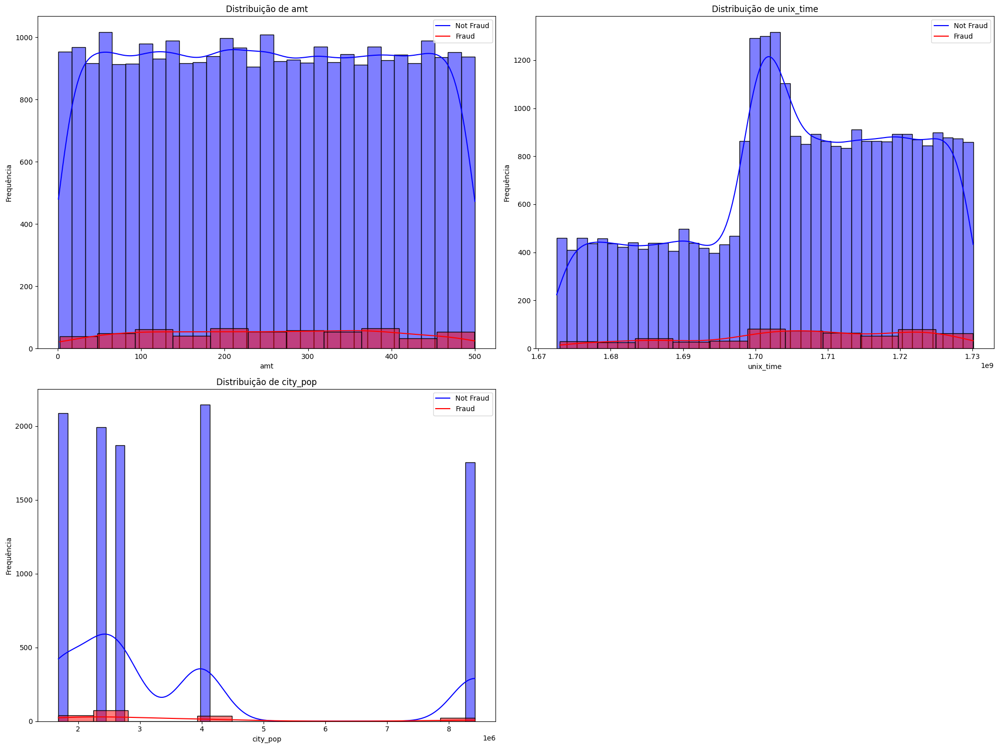

In [46]:
plt.figure(figsize = (20, 15))

is_fraud = data[data['is_fraud'] == 1][['amt', 'unix_time', 'city_pop']]
is_not_fraud = data[data['is_fraud'] == 0][['amt', 'unix_time', 'city_pop']]

# Iterar sobre as colunas numéricas e criar gráficos
for i, col in enumerate(is_fraud.columns):
    plt.subplot(2, 2, i + 1)
    sb.histplot(data=is_not_fraud[col], label='Not Fraud', color='blue', kde=True, alpha=0.5)
    sb.histplot(data=is_fraud[col], label='Fraud', color='red', kde=True, alpha=0.5)
    plt.legend(plt.gca().get_legend_handles_labels()[1])
    plt.title(f"Distribuição de {col}")
    plt.xlabel(col)
    plt.ylabel("Frequência")

plt.tight_layout()
plt.show()

Transações fraudulentas tendem a estar distribuídas ao longo do intervalo de valores *amt*, mas têm picos menores em comparação com transações legítimas.

Seguem o mesmo padrão geral de *timestamps* que as legítimas, com uma distribuição mais concentrada em torno de certos horários (aumenta consideravelmente em 1.70).

Transações fraudulentas aparecem em cidades com diferentes populações, mas são mais frequentes em cidades pequenas e grandes.

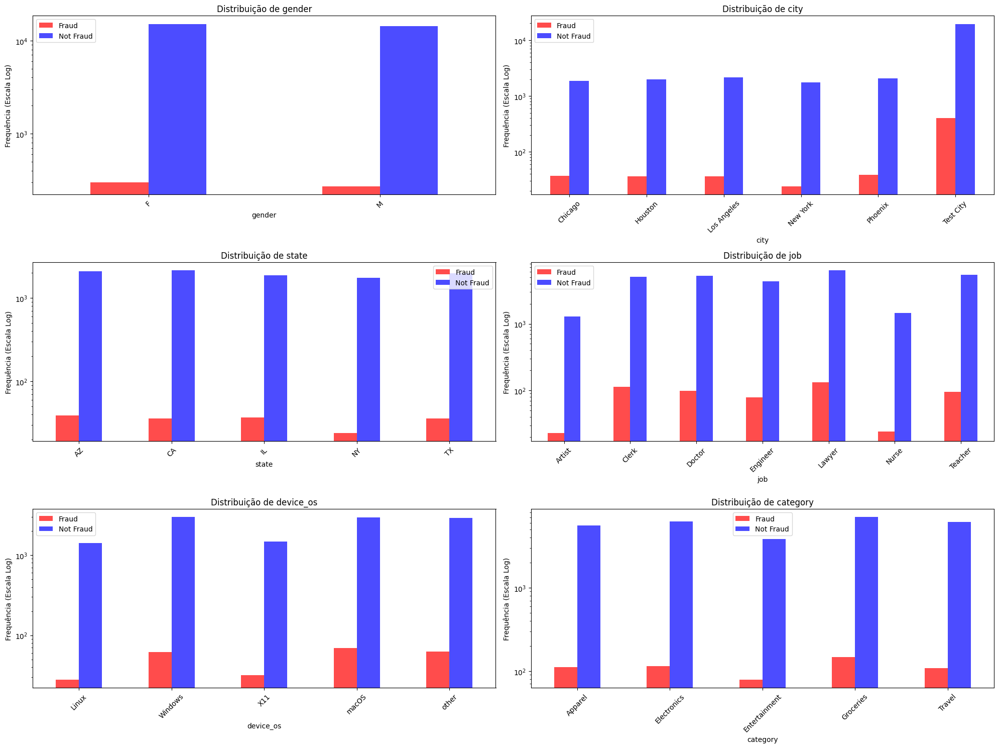

In [47]:
plt.figure(figsize=(20, 15))

is_fraud = data[data['is_fraud'] == 1][['gender', 'city', 'state', 'job', 'device_os', 'category']]
is_not_fraud = data[data['is_fraud'] == 0][['gender', 'city', 'state', 'job', 'device_os', 'category']]

# Iterar sobre as colunas categóricas e criar gráficos
for i, col in enumerate(is_fraud.columns):
    plt.subplot(3, 2, i + 1)
    
    fraud_counts = is_fraud[col].value_counts()
    not_fraud_counts = is_not_fraud[col].value_counts()
    
    combined = pd.DataFrame({
        'Fraud': fraud_counts,
        'Not Fraud': not_fraud_counts
    }).fillna(0)
    
    combined.plot(kind='bar', ax=plt.gca(), color=['red', 'blue'], alpha=0.7)
    plt.title(f"Distribuição de {col}")
    plt.xlabel(col)
    plt.ylabel("Frequência (Escala Log)")
    plt.yscale('log')  # Escala logarítmica
    plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

Ambos os géneros possuem uma proporção semelhante de fraudes em relação a transações legítimas, logo poderá ser pertinente numa próxima fase combinarmos este atributo com outros para perceber se existe alguma relação.

Como já visto, a cidade **Test City** tem uma proporção mais alta de fraude em relação às outras.

A proporção de fraudes é semelhante entre os estados, logo também poderá ser interessante combinar este atributo com outros.

Certas profissões, como **Lawyer** e **Clerk**, têm volumes maiores de transações legítimas e fraudulentas. O mesmo quando temos em conta os sitemas operativos **macOs** e **windows**.

A variável **category** pode ser um bom indicador, especialmente em categorias específicas, como **Groceries** e **Electronics**, que podem ser mais suscetíveis a fraudes.

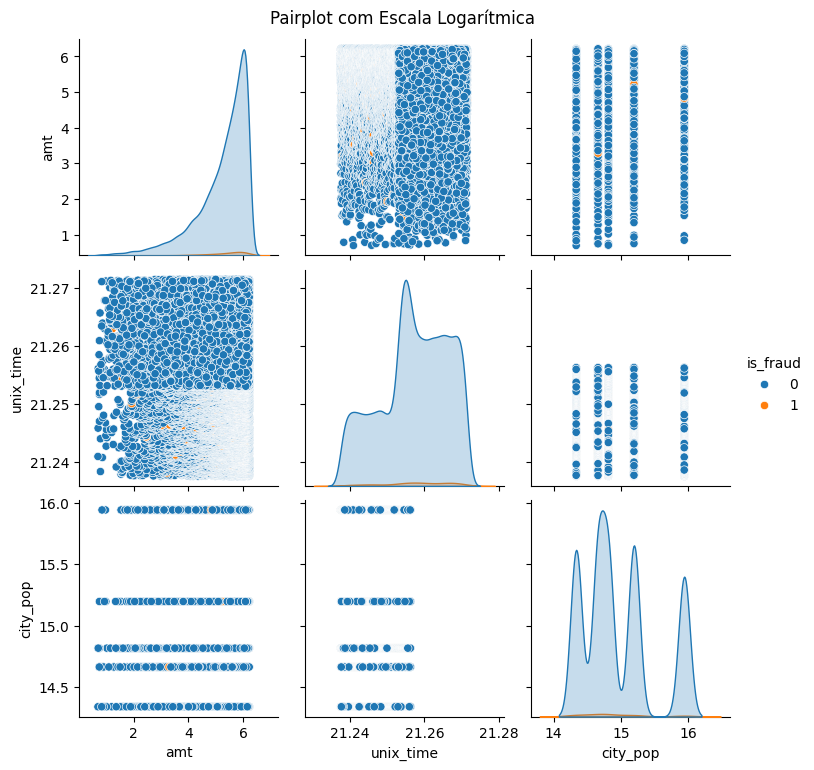

In [48]:
data_log_scaled = data[['amt', 'unix_time', 'city_pop', 'is_fraud']].copy()

# Escala logarítmica
for col in ['amt', 'unix_time', 'city_pop']:
    data_log_scaled[col] = np.log1p(data_log_scaled[col])

# Criar o pairplot
sb.pairplot(data_log_scaled, hue='is_fraud', diag_kind='kde', height=2.5)
plt.suptitle("Pairplot com Escala Logarítmica", y=1.02)
plt.show()

Estes novos gráficos não nos acrescentam mais informação do que aquela que já tínhamos, mas ajudam a reforçar as conclusões anteriores.

In [49]:
# Criar o mapa sem valores inválidos
mapa = folium.Map(location=[20, 0], zoom_start=2)
mapa_data = data.dropna(subset=['lat', 'long', 'merch_lat', 'merch_long'])

# Adicionar as localizaçoes dos comerciantes
for _, row in mapa_data.iterrows():
    folium.CircleMarker(
        location=[row['merch_lat'], row['merch_long']],
        radius=6,
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0.7,
        popup=f"Comerciante: ({row['merch_lat']}, {row['merch_long']})"
    ).add_to(mapa)

# Adicionar as localizações dos utilizadores
for _, row in mapa_data.iterrows():
    folium.CircleMarker(
        location=[row['lat'], row['long']],
        radius=6,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.7,
        popup=f"Utilizador: ({row['lat']}, {row['long']})"
    ).add_to(mapa)

mapa

Para entender melhor os valores de latitude e longitude foi criada a visualização acima. Os pontos a **azul** identificam as localizações dos **utilizadores** e os pontos a **vermelho** as localizações dos **comerciantes**.

A primeira observação que podemos retirar é que existe mais informação da localização dos comerciantes e que existem vários pontos em sítios que não fazem muito sentido, por exemplo, no meio do mar. Podemos concluir que parece que só a latitude e a longitude não nos darão muita informação relevante para a deteção de fraude, mas será interessante combinar estes atributos com outros para perceber se existe alguma relação.

Quando a distância entre os pontos de localização é grande ou inesperada, especialmente num curto intervalo de tempo, pode-se identificar anomalias que indicam possíveis fraudes. Por exemplo, se um utilizador legítimo está localizado numa cidade, mas uma transação ocorre num local muito distante, isso pode sugerir que os dados do cartão foram comprometidos.

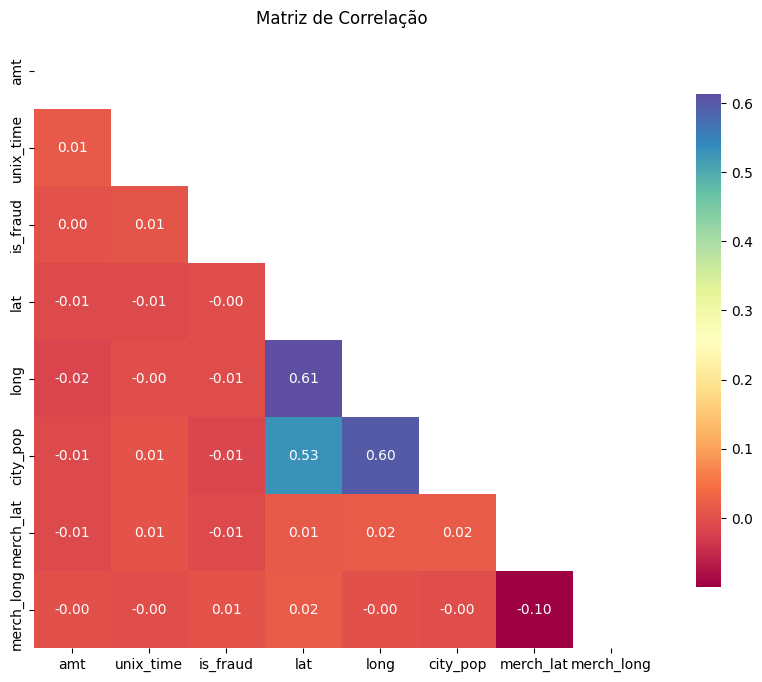

In [50]:
numeric_data = data.select_dtypes(include=['float64', 'int64'])
numeric_data = numeric_data.drop(['cc_num', 'index', 'zip', 'merchant_id'], axis=1, errors='ignore')

# Criar a matriz de correlação
correlation_matrix = numeric_data.corr()

# retirar a parte superior da matriz
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))

plt.figure(figsize=(12, 8))
sb.heatmap(correlation_matrix, mask=mask, annot=True, fmt=".2f", cmap="Spectral", square=True, cbar_kws={"shrink": .8})

plt.title("Matriz de Correlação")
plt.show()

Todas as variáveis numéricas têm **correlação muito baixa** com a variável alvo **is_fraud**. Isto sugere que nenhuma das variáveis apresenta uma relação linear direta forte com a ocorrência de fraudes, o que pode indicar que as fraudes podem ser influenciadas por combinações mais complexas das variáveis, em vez de relações isoladas ou lineares. Esta conclusão já tinha sido retirada para alguns atributos nos textos anteriores.

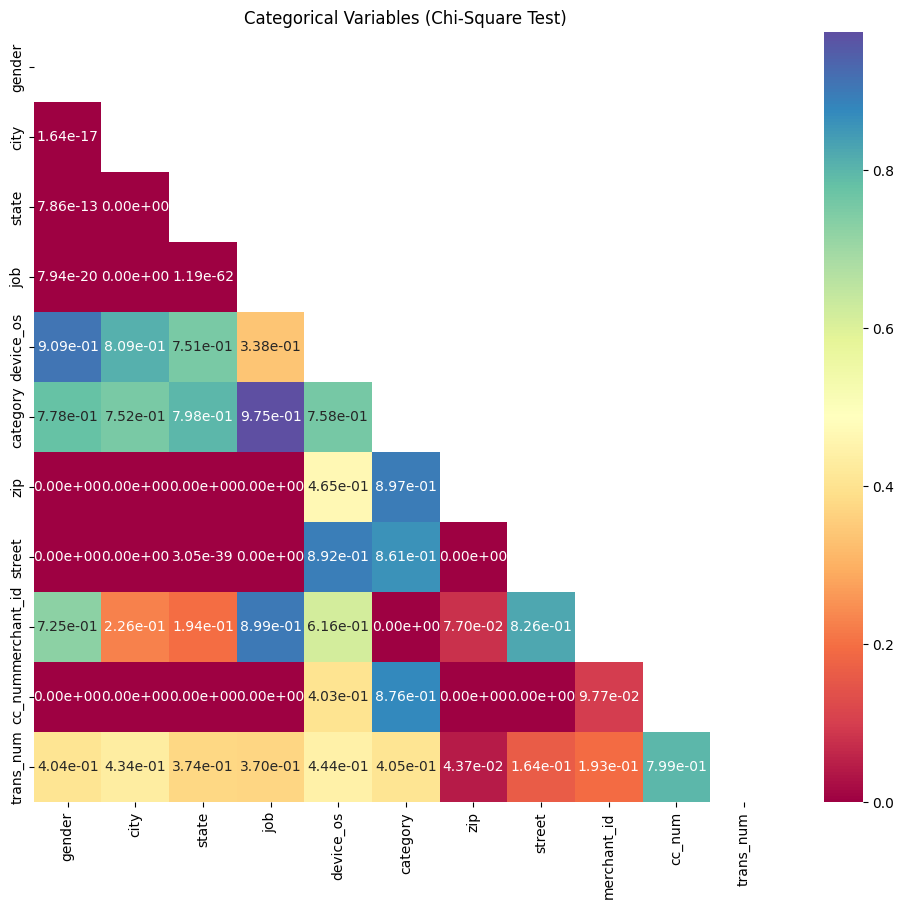

In [51]:
categorical_vars = ['gender', 'city', 'state', 'job', 'device_os', 'category', 'zip', 'street', 'merchant_id', 'cc_num', 'trans_num']
df_categorical = data[categorical_vars]

# Criar uma matriz para guardar os p-valores
p_values_matrix = pd.DataFrame(index=categorical_vars, columns=categorical_vars)

# Calcular o qui-quadrado para cada par de variáveis
for var1 in categorical_vars:
    for var2 in categorical_vars:
        if var1 == var2:
            p_values_matrix.loc[var1, var2] = np.nan  # Ignorar a diagonal principal
        else:
            contingency_table = pd.crosstab(df_categorical[var1], df_categorical[var2])
            try:
                _, p_value, _, _ = chi2_contingency(contingency_table)
                p_values_matrix.loc[var1, var2] = p_value
            except ValueError:
                p_values_matrix.loc[var1, var2] = np.nan  # Caso não seja possível calcular

# Converter os valores para float
p_values_matrix = p_values_matrix.astype(float)

# Retirar a parte superior da matriz
mask = np.tril(np.ones(p_values_matrix.shape), k=-1) 
p_values_matrix_masked = p_values_matrix.where(mask == 1)

# Criar heatmap
plt.figure(figsize=(12, 10))
sb.heatmap(p_values_matrix_masked, annot=True, fmt=".2e", cmap="Spectral", cbar=True)
plt.title("Categorical Variables (Chi-Square Test)")
plt.show()

Como a matriz de correlação das variáveis numéricas não apresenta correlações fortes com a variável alvo, foi necessário analisar as variáveis categóricas para perceber se existe alguma relação com a variável alvo.

A matriz apresenta *p-valores* para cada par de variáveis, indicando a probabilidade das variáveis serem independentes entre elas - hipótese *H0*. *p-valores* baixos sugerem que existe uma relação estatisticamente significativa entre as variáveis, enquanto p-valores altos indicam que não há evidências suficientes para rejeitar a hipótese *H0*. A coloração da matriz ilustra essas relações, com tons de vermelho indicado relações fortes de dependência e portanto rejeição da hipótese *H0* e os outros tons representam mais independência, logo não rejeitamos *H0*.

Relações fortes (p-valores muito baixos), como esperado, dada a correlação geográfica entre **state**, **city** e **zip**. Esses padrões podem ajudar a identificar locais de alto risco para fraudes.

*p-valores* baixos, indicando qu a categoria e o *id* do comerciante pode, estar relacionados. Pode ser usado para verificar anomalias no comportamento dos comerciantes.

Também se pode concluir que o **cc_num** está bastante relacionado com a **localização**, o **gender** e o **job** do utilizador.

Vamos verificar agora a qualidade dos dados antes de fazer a preparação dos mesmos. Pertende-se identificar erros e inconsistências nos dados, como valores ausentes, duplicados, entre outros.

In [52]:
data.isnull().sum()

index                        0
trans_date_trans_time      100
cc_num                       0
device_os                17964
merchant                     0
amt                        100
trans_num                    0
unix_time                    0
is_fraud                     0
first                       10
last                        10
gender                      10
street                      10
city                        10
zip                        216
job                        216
dob                         10
lat                      19980
long                     19980
city_pop                 19980
state                    19980
category                   599
merch_lat                  599
merch_long                  10
merchant_id                 10
dtype: int64

Focando apenas nas variável mais relevantes, conseguimos verificar que existem alguns valores em falta em **amt**, **device_os**, **gender**, **city**, **job**, **dob** e **category**, entre outros. Estes valores em falta podem ser preenchidos, dependendo do tipo de variável e da sua distribuição na próxima etapa.

Podemos também verificar que, para atributos que representam essencialmente a mesma informação, há inconsistências nos valores ausentes. Por exemplo, no caso dos atributos **merchant** e **merchant_id**, observamos que existem valores ausentes em **merchant_id**, mas não em **merchant**. Portanto, optamos por manter o atributo **merchant**, que possui informações mais completas. Da mesma forma, para os atributos **trans_date_trans_time** e **unix_time**, verificamos que **unix_time** não apresenta valores ausentes, enquanto **trans_date_trans_time** possui. Assim, escolhemos o atributo **unix_time**. Na próxima fase trataremos de remover os que não são relevantes.

Identificamos que os atributos **lat** e **long** possuem uma quantidade significativa de valores ausentes. Além disso, a ampla distribuição desses valores torna inviável preenchê-los de forma consistente e coerente, sem introduzir vieses ou comprometer a qualidade dos dados. Por este motivo, decidimos remover esses atributos da análise. Da mesma forma, ao avaliar os atributos **merch_lat** e **merch_long**, verificamos que **merch_lat** apresenta ainda mais valores ausentes do que **merch_long**. Considerando essa inconsistência e a dificuldade de completar essas informações de maneira confiável, optamos por remover ambos os atributos relacionados com a localização do comerciante.

In [53]:
data.nunique()

index                    29970
trans_date_trans_time    29868
cc_num                    1101
device_os                    5
merchant                   101
amt                      22615
trans_num                29470
unix_time                29959
is_fraud                     2
first                      108
last                       108
gender                       2
street                     102
city                         6
zip                       1077
job                          7
dob                       1062
lat                          5
long                         5
city_pop                     5
state                        5
category                     5
merch_lat                   98
merch_long                 100
merchant_id                100
dtype: int64

In [54]:
print(data.duplicated(subset='trans_num').sum())

530


In [55]:
data['is_fraud'].unique()

array([0, 1], dtype=int64)

In [56]:
data['gender'].unique()

array(['F', 'M', nan], dtype=object)

In [57]:
data['category'].unique()

array([nan, 'Entertainment', 'Electronics', 'Groceries', 'Apparel',
       'Travel'], dtype=object)

In [58]:
data['job'].unique()

array([nan, 'Nurse', 'Doctor', 'Teacher', 'Engineer', 'Clerk', 'Artist',
       'Lawyer'], dtype=object)

In [59]:
data['device_os'].unique()

array([nan, 'macOS', 'X11', 'other', 'Windows', 'Linux'], dtype=object)

In [60]:
data['city'].unique()

array(['Chicago', 'New York', 'Phoenix', 'Los Angeles', 'Houston', nan,
       'Test City'], dtype=object)

Os valores do atributo **trans_num** deveriam ser todos únicos mas existem **530** repetidos. Os duplicados devem ser, portanto, removidos. 

Ficamos, também, com informação que os valores dos atributos categóricos descritos acima são todos plausíveis, não tendo erros de codificação ou valores inválidos.

O atributo booleano assume só valores de **0** ou **1**, o que é o esperado.

## Preparação dos Dados

Tendo em conta a análise feita anteriormente, devem ser excluídos os atributos irrelevantes para o modelo, como **index**, **first**, **last**, **lat**, **long**, **merch_lat**, **merch_long**, **merchant_id** e **trans_date_trans_time**. 

In [61]:
filtered_data = data.drop(columns= ['index', 'first', 'last', 'lat', 'long', 'merch_lat', 'merch_long', 'merchant_id', 'trans_date_trans_time', 'street', 'zip'])

filtered_data.head()

,cc_num,device_os,merchant,amt,trans_num,unix_time,is_fraud,gender,city,job,dob,city_pop,state,category
0,2801374844713453,NaN,Merchant_85,252.75,TRANS_662964,1672533543,0,F,Chicago,NaN,2002-10-12,2716000.0,IL,NaN
1,3460245159749480,NaN,Merchant_23,340.17,TRANS_134939,1672535768,0,M,New York,Nurse,2001-12-23,8419600.0,NY,Entertainment
2,7308701990157768,macOS,Merchant_70,76.38,TRANS_258923,1672536268,0,M,Phoenix,Doctor,1978-12-13,1680992.0,AZ,Electronics
3,8454886440761098,X11,Merchant_33,368.88,TRANS_226814,1672538817,0,F,Phoenix,Teacher,1965-04-21,1680992.0,AZ,Electronics
4,6350332939133843,NaN,Merchant_90,323.32,TRANS_668449,1672539054,0,F,New York,Nurse,1997-05-17,8419600.0,NY,Groceries


Agora vamos limpar os dados e construir os que forem necessário para depois testar o modelo.

Focando no atributo *trans_num*, a análise identificou 530 valores duplicados. Alguns correspondiam a linhas idênticas, permitindo a remoção de qualquer uma. No entanto, em casos onde as linhas apresentavam diferenças, como a presença de valores *NA*, priorizou-se a remoção das linhas com maior número de *NA*.

In [62]:
filtered_data['num_na'] = filtered_data.isna().sum(axis=1)

# Selecionar a melhor linha para cada valor único no atributo
df_unico = filtered_data.loc[filtered_data.groupby('trans_num')['num_na'].idxmin()].reset_index(drop=True)

print(df_unico.duplicated(subset='trans_num').sum())

filtered_data = df_unico.drop(columns=['num_na'])

0


Para preencher os valores em falta, vai se usar o **knn imputer**. Este método preenche os valores em falta com base nos valores mais próximos, sendo uma boa opção para preencher valores em falta nas variáveis numéricas. Como ainda temos várias variáveis categóricas vamos convertê-las para numéricas realizando **OneHotEncoder**.

Primeiramente, convertemos a data de nascimento em idade, facilitando a interpretação do modelo. Além disso, considerando que as colunas **merchant** e **trans_num** possuem formatos específicos (*Merchant_XX* e *trans_XXXXXX*, respectivamente), removeremos as letras e manteremos apenas os identificadores numéricos, que são os elementos realmente relevantes para a análise.

In [63]:
filtered_data['dob'] = pd.to_datetime(filtered_data['dob'])

# Calcular a idade com base na data atual
today = datetime.today()
filtered_data['dob'] = filtered_data['dob'].apply(lambda x: today.year - x.year - ((today.month, today.day) < (x.month, x.day)))

filtered_data.head()

,cc_num,device_os,merchant,amt,trans_num,unix_time,is_fraud,gender,city,job,dob,city_pop,state,category
0,4347299737056228,macOS,Merchant_89,306.22,TRANS_100073,1701842847,0,M,Houston,Nurse,27,2328000.0,TX,Groceries
1,6721272427443861,NaN,Merchant_69,141.68,TRANS_100090,1680849980,0,M,Los Angeles,Artist,61,3979576.0,CA,Groceries
2,5158700527909339,macOS,Merchant_41,366.67,TRANS_100097,1697204826,0,F,Phoenix,Nurse,68,1680992.0,AZ,Apparel
3,2980147560808381,NaN,Merchant_45,371.36,TRANS_100126,1697055562,0,M,Phoenix,Lawyer,36,1680992.0,AZ,Groceries
4,6624582838462944,macOS,Merchant_95,205.11,TRANS_100188,1705427153,0,M,Test City,Lawyer,69,NaN,NaN,Groceries


In [64]:
filtered_data['merchant'] = filtered_data['merchant'].apply(lambda x: ''.join(re.findall(r'\d+', x)))
filtered_data['trans_num'] = filtered_data['trans_num'].apply(lambda x: ''.join(re.findall(r'\d+', x)))

filtered_data['merchant'] = pd.to_numeric(filtered_data['merchant'], errors='coerce')
filtered_data['trans_num'] = pd.to_numeric(filtered_data['trans_num'], errors='coerce')

filtered_data.head()

,cc_num,device_os,merchant,amt,trans_num,unix_time,is_fraud,gender,city,job,dob,city_pop,state,category
0,4347299737056228,macOS,89,306.22,100073,1701842847,0,M,Houston,Nurse,27,2328000.0,TX,Groceries
1,6721272427443861,NaN,69,141.68,100090,1680849980,0,M,Los Angeles,Artist,61,3979576.0,CA,Groceries
2,5158700527909339,macOS,41,366.67,100097,1697204826,0,F,Phoenix,Nurse,68,1680992.0,AZ,Apparel
3,2980147560808381,NaN,45,371.36,100126,1697055562,0,M,Phoenix,Lawyer,36,1680992.0,AZ,Groceries
4,6624582838462944,macOS,95,205.11,100188,1705427153,0,M,Test City,Lawyer,69,NaN,NaN,Groceries


In [65]:
clean_data = pd.get_dummies(filtered_data, drop_first=True, dummy_na=True, dtype=int)

clean_data.dtypes

cc_num                      int64
merchant                    int64
amt                       float64
trans_num                   int64
unix_time                   int64
is_fraud                    int64
dob                         int64
city_pop                  float64
device_os_Windows           int32
device_os_X11               int32
device_os_macOS             int32
device_os_other             int32
device_os_nan               int32
gender_M                    int32
gender_nan                  int32
city_Houston                int32
city_Los Angeles            int32
city_New York               int32
city_Phoenix                int32
city_Test City              int32
city_nan                    int32
job_Clerk                   int32
job_Doctor                  int32
job_Engineer                int32
job_Lawyer                  int32
job_Nurse                   int32
job_Teacher                 int32
job_nan                     int32
state_CA                    int32
state_IL      

In [66]:
# Instanciar o KNNImputer
imputer = KNNImputer(n_neighbors=5, weights="uniform")  # Ou weights="distance"

# Aplicar a imputação
df_imputed = imputer.fit_transform(clean_data)

# Converter de volta para um DataFrame com os mesmos nomes de coluna
df_imputed = pd.DataFrame(df_imputed, columns=clean_data.columns)

In [69]:
df_imputed.isna().sum()

cc_num                    0
merchant                  0
amt                       0
trans_num                 0
unix_time                 0
is_fraud                  0
dob                       0
city_pop                  0
device_os_Windows         0
device_os_X11             0
device_os_macOS           0
device_os_other           0
device_os_nan             0
gender_M                  0
gender_nan                0
city_Houston              0
city_Los Angeles          0
city_New York             0
city_Phoenix              0
city_Test City            0
city_nan                  0
job_Clerk                 0
job_Doctor                0
job_Engineer              0
job_Lawyer                0
job_Nurse                 0
job_Teacher               0
job_nan                   0
state_CA                  0
state_IL                  0
state_NY                  0
state_TX                  0
state_nan                 0
category_Electronics      0
category_Entertainment    0
category_Groceries  